---
## Import Libraies and Load data

In [1]:
#Modifikasi
import warnings
import zipfile
import numpy as np
import pandas as pd
from pathlib import Path
pd.set_option('display.max_columns', 100)

#Visualisasi
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly_express as px
import plotly.subplots as sp
from statsmodels.graphics.tsaplots import plot_acf
from matplotlib import rcParams

#Perhitungan
import itertools
from statsmodels.formula.api import ols
import statsmodels.api as sm
from geopy.geocoders import Nominatim
from scipy import stats
from statsmodels.tsa.seasonal import seasonal_decompose


#Imputasi
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression


# Modeling
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA


In [2]:
train = pd.read_csv('raw_dataset/Train.csv')
test = pd.read_csv('raw_dataset/Test.csv')

---
## Data Understanding (Train and Test)

In [3]:
train.head()

,ID_Zindi,Date,ID,LAT,LON,Precipitation,LST,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2
0,ID_ENTGC7,1/1/19,PD01,45.601585,11.903551,0.000000,NaN,0.230527,0.559117,0.000024,0.000117,NaN,14440.82126,31.0
1,ID_8JCCXC,1/1/19,PD04,45.371005,11.840830,3.047342,NaN,-0.074006,0.869309,0.000024,0.000127,NaN,14441.79815,42.0
2,ID_V3136Z,1/1/19,RO01,45.045825,12.060869,0.000000,NaN,0.024470,0.674160,0.000024,0.000086,NaN,14437.38294,31.0
3,ID_KRVZDJ,1/1/19,RO02,45.104075,11.553241,1.200467,NaN,-0.010442,0.920054,0.000024,0.000124,NaN,14440.83831,30.0
4,ID_PR351A,1/1/19,RO03,45.038758,11.790152,1.274564,NaN,-0.176178,0.747464,0.000024,0.000116,NaN,14438.79037,58.0


In [4]:
train.tail()

,ID_Zindi,Date,ID,LAT,LON,Precipitation,LST,AAI,CloudFraction,NO2_strat,NO2_total,NO2_trop,TropopausePressure,GT_NO2
86579,ID_NCWXIY,31-12-21,X9897,45.498227,9.556232,0.0,NaN,-0.434350,0.250490,0.000032,0.000643,NaN,13063.79770,39.750
86580,ID_UDQIEE,31-12-21,X9928,45.142541,10.043836,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30.125
86581,ID_ENDUPX,31-12-21,X9969,45.842207,9.351658,0.0,284.98,-0.157753,0.000000,0.000031,0.000153,0.000122,13050.16499,28.325
86582,ID_3ZBA6C,31-12-21,X9993,45.113503,8.874065,0.0,NaN,-0.798636,0.399524,0.000031,0.000717,NaN,13061.41329,21.250
86583,ID_GWG0LD,31-12-21,X9999,45.526473,9.515980,0.0,NaN,-0.434482,0.250530,0.000032,0.000643,NaN,13063.79500,40.350


In [5]:
train.info(),train.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86584 entries, 0 to 86583
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID_Zindi            86584 non-null  object 
 1   Date                86584 non-null  object 
 2   ID                  86584 non-null  object 
 3   LAT                 86584 non-null  float64
 4   LON                 86584 non-null  float64
 5   Precipitation       86584 non-null  float64
 6   LST                 46798 non-null  float64
 7   AAI                 73709 non-null  float64
 8   CloudFraction       73709 non-null  float64
 9   NO2_strat           73709 non-null  float64
 10  NO2_total           73709 non-null  float64
 11  NO2_trop            51111 non-null  float64
 12  TropopausePressure  73709 non-null  float64
 13  GT_NO2              82051 non-null  float64
dtypes: float64(11), object(3)
memory usage: 9.2+ MB


(None, (86584, 14))

In [6]:
train.isna().sum()

ID_Zindi                  0
Date                      0
ID                        0
LAT                       0
LON                       0
Precipitation             0
LST                   39786
AAI                   12875
CloudFraction         12875
NO2_strat             12875
NO2_total             12875
NO2_trop              35473
TropopausePressure    12875
GT_NO2                 4533
dtype: int64

In [7]:
train.drop(['ID','ID_Zindi'], axis=1, inplace=True)
test.drop(['ID','ID_Zindi'], axis=1, inplace=True)


---
## Data Cleaning

In [8]:
train['Date'] = pd.to_datetime(train['Date'], dayfirst=True, errors='coerce')

# 3. Menetapkan kolom Date sebagai index
train.set_index('Date', inplace=True)

C:\Users\booma\AppData\Local\Temp\ipykernel_24620\1795112415.py:1: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



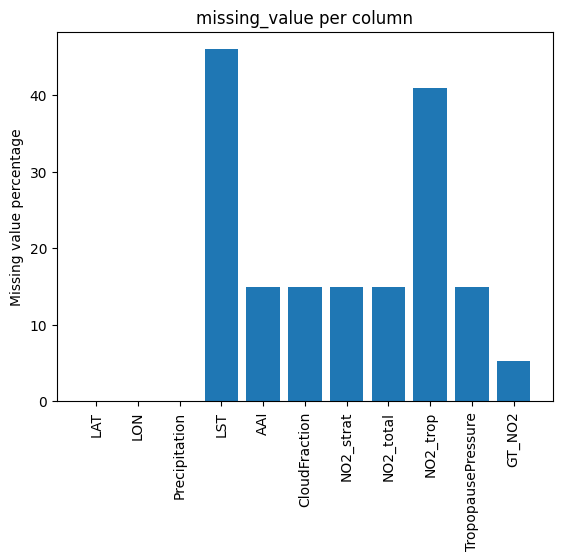

In [9]:
missing_train = (train.isna().sum() / len(train)) * 100
plt.bar(missing_train.index, missing_train.values)
plt.xticks(rotation=90)
plt.ylabel("Missing value percentage")
plt.title("missing_value per column")
plt.show()

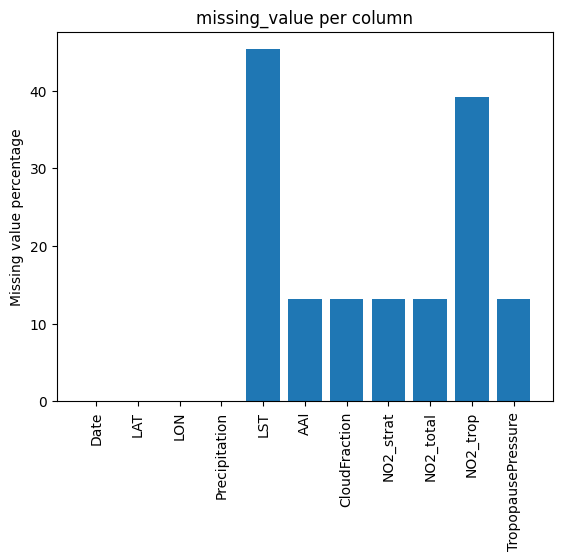

In [10]:
missing_test = (test.isna().sum() / len(test)) * 100
plt.bar(missing_test.index, missing_test.values)
plt.xticks(rotation=90)
plt.ylabel("Missing value percentage")
plt.title("missing_value per column")
plt.show()

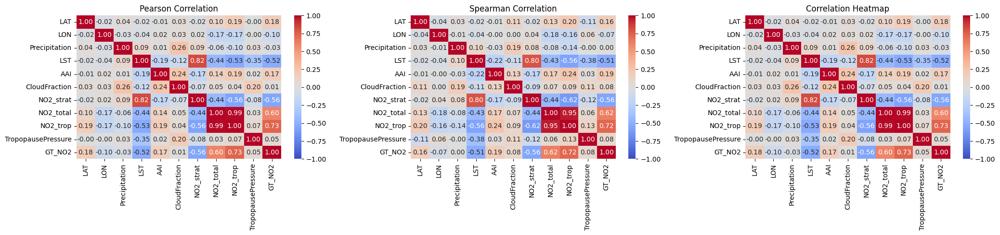

In [11]:
# Compute correlations
pearson_corr = train.corr(method='pearson')  # Pearson Correlation
spearman_corr = train.corr(method='spearman')  # Spearman Correlation
heatmap_corr = train.corr()  # Default (Pearson)

# Create subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(21, 5))

# Pearson Correlation Heatmap
sns.heatmap(pearson_corr, annot=True, cmap="coolwarm", fmt=".2f", ax=axes[0],vmin=-1,vmax=1)
axes[0].set_title("Pearson Correlation")

# Spearman Correlation Heatmap
sns.heatmap(spearman_corr, annot=True, cmap="coolwarm", fmt=".2f", ax=axes[1],vmin=-1,vmax=1)
axes[1].set_title("Spearman Correlation")

# General Correlation Heatmap
sns.heatmap(heatmap_corr, annot=True, cmap="coolwarm", fmt=".2f", ax=axes[2],vmin=-1,vmax=1)
axes[2].set_title("Correlation Heatmap")

# Display the plot
plt.tight_layout()
plt.show()

---
#### Imputation

In [12]:
# df = train.copy
# df.drop(columns=['ID_Zindi', 'ID'], inplace=True)
# test.drop(columns=['ID_Zindi', 'ID'], inplace=True)

# # List kolom yang akan diimputasi
# cols_to_impute_rf = ['AAI', 'CloudFraction', 'LST', 'NO2_trop', 'NO2_strat', 'NO2_total', 'TropopausePressure']

# # Dictionary untuk menyimpan model imputasi per kolom
# imputation_models = {}

# # Loop imputasi pada train
# for col in cols_to_impute_rf:
#     if df[col].isna().sum() > 0:  # Cek apakah ada NaN di train
#         non_missing_data = df[df[col].notna()]
#         X_train = non_missing_data.drop(columns=[col, 'LAT', 'LON'])  # Hapus kolom target & lokasi
#         y_train = non_missing_data[col]

#         # Inisiasi & training Random Forest Regressor
#         rf_imputer = RandomForestRegressor(n_estimators=100, random_state=42)
#         rf_imputer.fit(X_train, y_train)

#         # Simpan model imputasi untuk nanti digunakan di test
#         imputation_models[col] = rf_imputer

#         # Prediksi untuk nilai NaN di train
#         X_pred_train = df[df[col].isna()].drop(columns=[col, 'LAT', 'LON'])
#         df.loc[df[col].isna(), col] = rf_imputer.predict(X_pred_train)

# # Loop imputasi pada test (menggunakan model dari train)
# for col in cols_to_impute_rf:
#     if test[col].isna().sum() > 0:  # Cek apakah ada NaN di test
#         X_pred_test = test[test[col].isna()].drop(columns=[col, 'LAT', 'LON'])
#         test.loc[test[col].isna(), col] = imputation_models[col].predict(X_pred_test)


# # Imputasi untuk kolom dengan missing data sedikit (Mean Imputation)
# cols_to_impute_mean = ['GT_NO2']
# mean_imputer = SimpleImputer(strategy='mean')
# df[cols_to_impute_mean] = mean_imputer.fit_transform(df[cols_to_impute_mean])

# # Imputasi untuk kolom berbasis time series (Misalnya Precipitation)
# # Time series imputation using Iterative Imputer (Multiple Imputation)
# time_series_cols = ['Precipitation']
# time_series_imputer = IterativeImputer(random_state=42)
# df[time_series_cols] = time_series_imputer.fit_transform(df[time_series_cols])
# test[time_series_cols] = time_series_imputer.fit_transform(test[time_series_cols])

In [13]:
# df.to_csv('train_imputed_with_rf_regressor.csv', index=False)
# test.to_csv('test_imputed_with_rf_regressor.csv', index=False)

data = pd.read_csv('final_dataset/train_imputed_with_rf_regressor.csv')
dtest = pd.read_csv('final_dataset/test_imputed_with_rf_regressor.csv')

data.drop(['LAT','LON'],axis=1,inplace=True)
dtest.drop(['LAT','LON'],axis=1,inplace=True)

---
## EDA

In [14]:
colToVisual = ['Precipitation', 'LST', 'AAI', 'CloudFraction', 'NO2_strat', 'NO2_total', 'TropopausePressure', 'GT_NO2', 'NO2_trop']

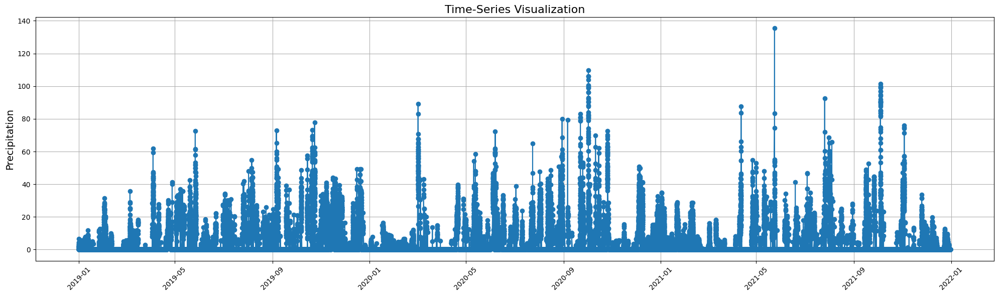

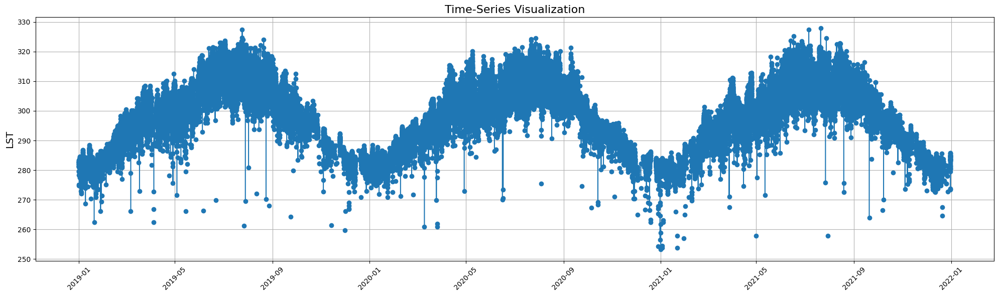

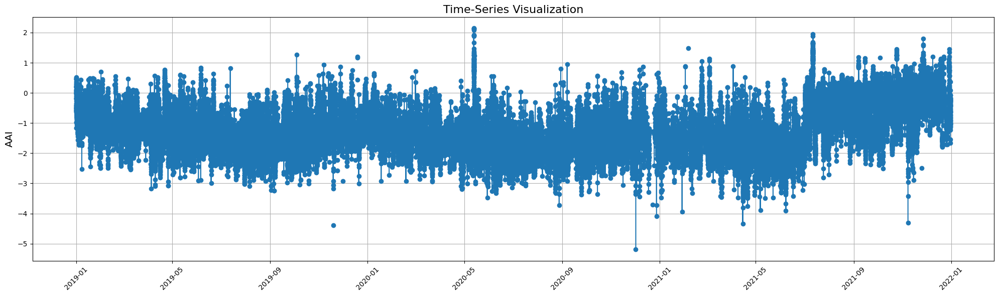

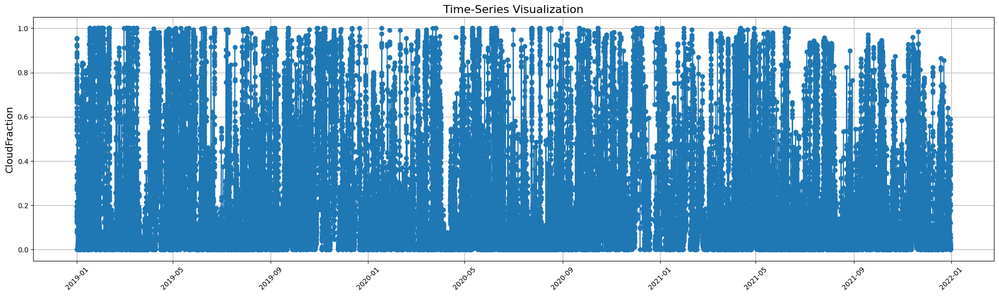

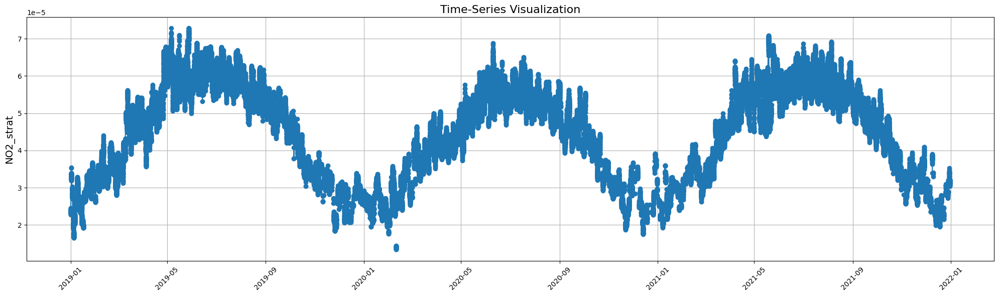

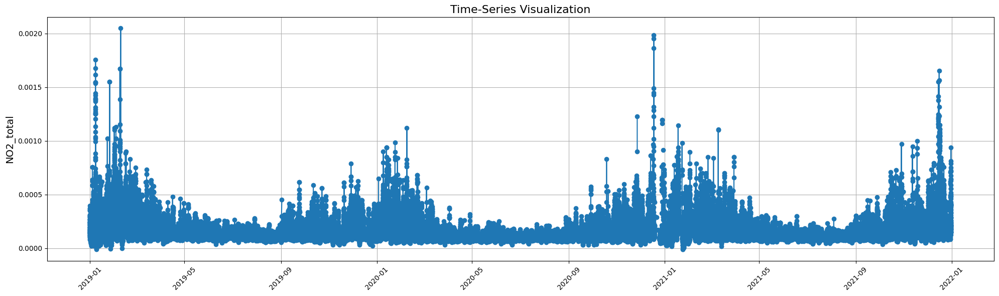

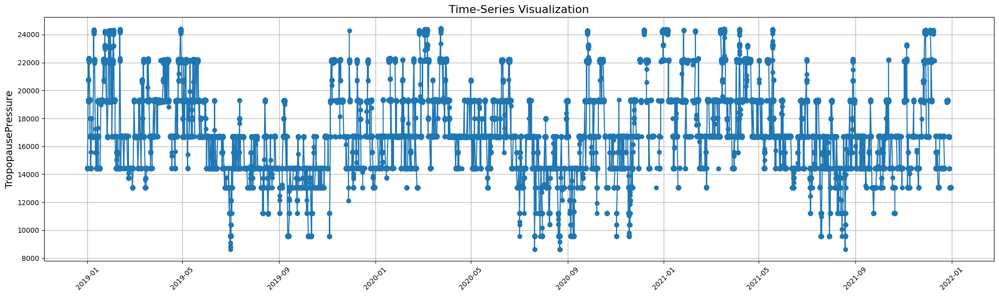

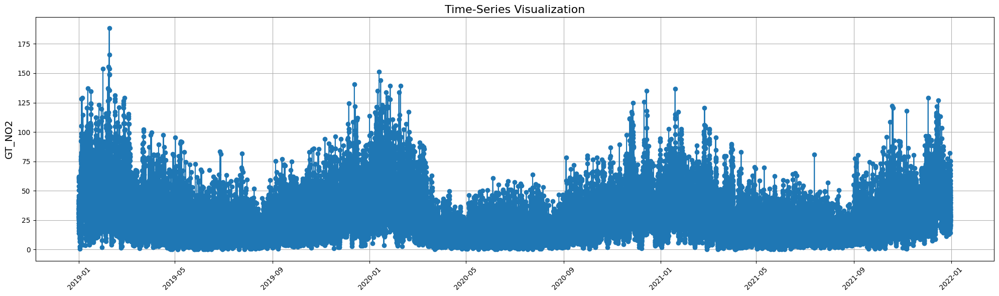

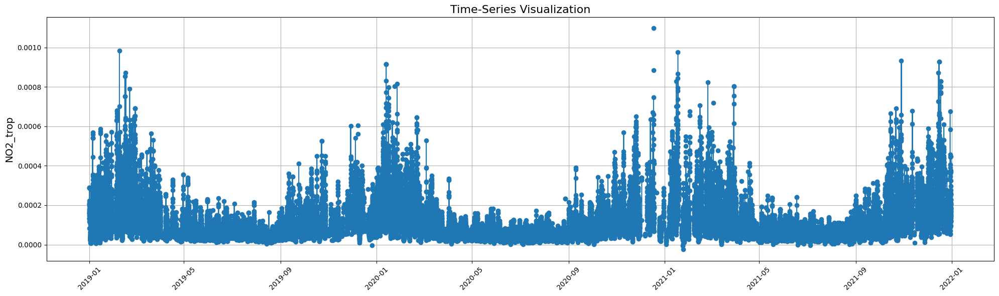

In [15]:
for col in colToVisual:
    plt.figure(figsize=(20, 6))
    plt.plot(train.index, train[col], marker='o')
    plt.title('Time-Series Visualization', fontsize=16)
    plt.ylabel(f'{col}', fontsize=14)
    plt.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


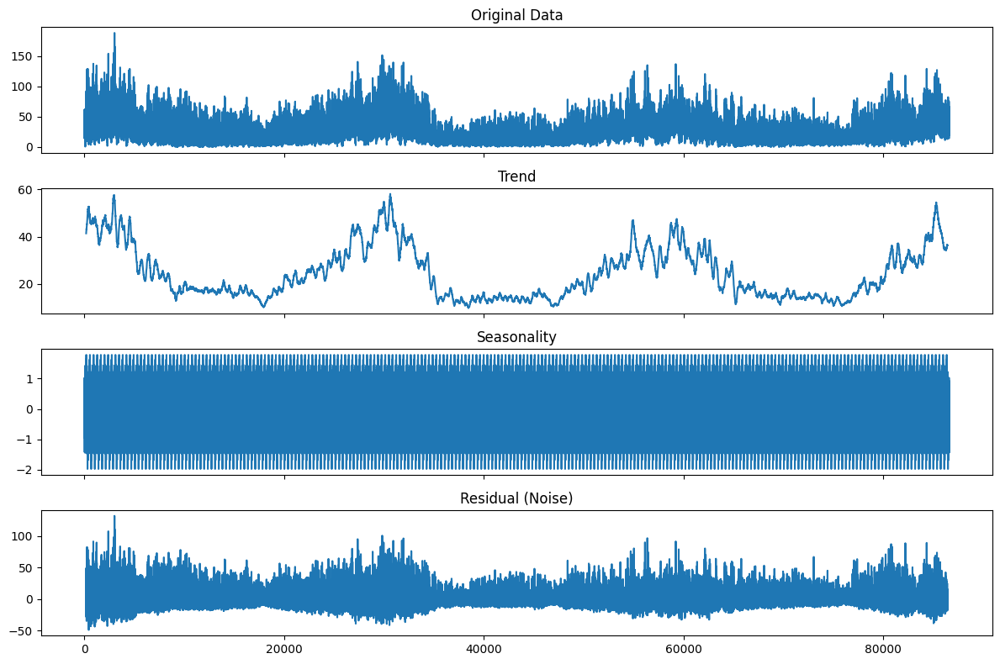

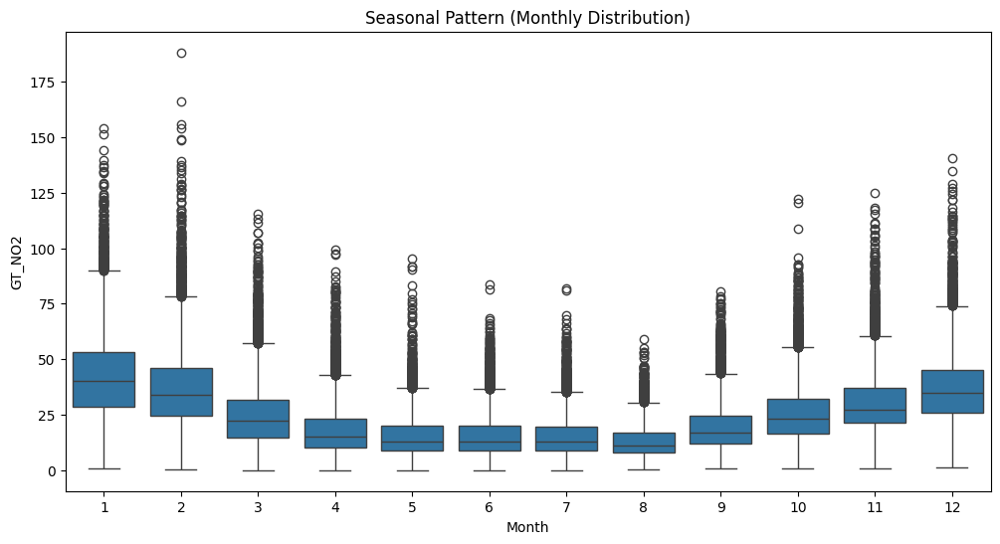

In [16]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Pilih kolom yang ingin dianalisis (misalnya NO2_strat)
target_col = "GT_NO2"

# Cek apakah data memiliki missing values
data[target_col] = data[target_col].interpolate()  # Interpolasi untuk mengisi missing values jika ada

# Decomposisi Time Series (Additive atau Multiplicative)
decomposition = seasonal_decompose(data[target_col], model='additive', period=365)  # Sesuaikan periodenya

# Plot hasil decomposisi
fig, ax = plt.subplots(4, 1, figsize=(12, 8), sharex=True)

decomposition.observed.plot(ax=ax[0], title="Original Data")
decomposition.trend.plot(ax=ax[1], title="Trend")
decomposition.seasonal.plot(ax=ax[2], title="Seasonality")
decomposition.resid.plot(ax=ax[3], title="Residual (Noise)")

plt.tight_layout()
plt.show()

# Opsional: Cek pola musiman dengan boxplot
data["month"] = train.index.month
data["year"] = train.index.year

plt.figure(figsize=(12, 6))
sns.boxplot(x=data["month"], y=data[target_col])
plt.title("Seasonal Pattern (Monthly Distribution)")
plt.xlabel("Month")
plt.ylabel(target_col)
plt.show()


In [17]:
# Sinusoidal Encoding Bulan ``
data['month_Sin'] = np.sin(2 * np.pi * data['month'] / 12)
data['month_Cos'] = np.cos(2 * np.pi * data['month'] / 12)

# Fitur Elapsed months (pastikan tahun dimulai dari min tahun di data)
min_year = data['year'].min()
data['Elapsed_months'] = (data['year'] - min_year) * 12 + data['month']

# Quarter & Semester
data['Quarter'] = ((data['month'] - 1) // 3 + 1).astype(int)

data['Semester'] = ((data['month'] - 1) // 6 + 1).astype(int)

# year-month Identifier (Format YYYYMM)
data['yearmonth'] = (data['year'] * 100 + data['month']).astype(int)

#### Check range value for all columns

In [18]:
# Tentukan ukuran grid
num_columns = len(data.columns)
num_rows = int(np.ceil(num_columns /3))  # Membuat 3 kolom per baris

# Siapkan subplot
fig = sp.make_subplots(rows=num_rows, cols=3, subplot_titles=[f'Distribusi {col}' for col in data.columns])

# Looping untuk setiap kolom dan tambahkan histogram ke subplot
for i, col in enumerate(data.columns):
    row = i // 3 + 1
    col_pos = i % 3 + 1
    hist_data = data[col].dropna()  # Hilangkan NaN untuk histogram
    fig.add_trace(
        go.Histogram(x=hist_data, nbinsx=30, name=col, opacity=0.75),
        row=row,
        col=col_pos
    )

# Menyesuaikan tata letak
fig.update_layout(
    height=300 * num_rows,
    width=1000,
    showlegend=False,
    title_text='Distribusi Histogram Kolom',
    title_x=0.5,
)

fig.update_xaxes(title_text="Value")
fig.update_yaxes(title_text="Frequency")

fig.show()

In [19]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
import pandas as pd

# Misalkan df adalah dataframe yang berisi fitur-fitur kamu
X = data[['LST', 'NO2_strat', 'NO2_total', 'NO2_trop', 'Precipitation', 'CloudFraction', 'TropopausePressure']]

# Tambahkan intercept untuk model regresi
X['Intercept'] = 1

# Hitung VIF untuk setiap variabel
vif_data = pd.DataFrame()
vif_data["Feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(len(X.columns))]

# Print hasil
print(vif_data)


C:\Users\booma\AppData\Local\Temp\ipykernel_24620\1238367850.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



              Feature          VIF
0                 LST     5.646118
1           NO2_strat     5.084462
2           NO2_total    20.899869
3            NO2_trop    23.642686
4       Precipitation     1.132436
5       CloudFraction     1.436535
6  TropopausePressure     1.320824
7           Intercept  2408.460617


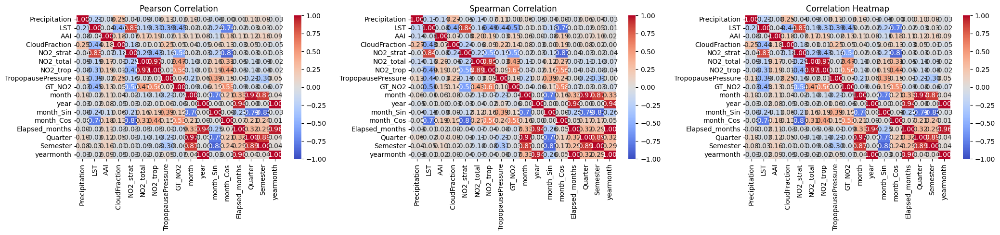

In [20]:
# Compute correlations
pearson_corr = data.corr(method='pearson')  # Pearson Correlation
spearman_corr = data.corr(method='spearman')  # Spearman Correlation
heatmap_corr = data.corr()  # Default (Pearson)

# Create subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(21, 5))

# Pearson Correlation Heatmap
sns.heatmap(pearson_corr, annot=True, cmap="coolwarm", fmt=".2f", ax=axes[0],vmin=-1,vmax=1)
axes[0].set_title("Pearson Correlation")

# Spearman Correlation Heatmap
sns.heatmap(spearman_corr, annot=True, cmap="coolwarm", fmt=".2f", ax=axes[1],vmin=-1,vmax=1)
axes[1].set_title("Spearman Correlation")

# General Correlation Heatmap
sns.heatmap(heatmap_corr, annot=True, cmap="coolwarm", fmt=".2f", ax=axes[2],vmin=-1,vmax=1)
axes[2].set_title("Correlation Heatmap")

# Display the plot
plt.tight_layout()
plt.show()

# Feature Engineering

In [21]:
kmeans = KMeans(n_clusters=3)
data['Kmeans'] = kmeans.fit_predict(data[['NO2_strat', 'NO2_total', 'NO2_trop']])

In [22]:
scaler = StandardScaler()
data['TropopausePressure'] = scaler.fit_transform(data[['TropopausePressure']])

In [23]:
from sklearn.preprocessing import PolynomialFeatures

# Misalnya, data berisi kolom 'Precipitation', 'LST', 'AAI'
poly = PolynomialFeatures(degree=2)

# Menerapkan transformasi polinomial pada kolom-kolom yang ditentukan
poly_features = poly.fit_transform(data[['Precipitation', 'LST', 'AAI']])

# Membuat DataFrame baru dengan nama kolom yang sesuai
poly_feature_columns = poly.get_feature_names_out(['Precipitation', 'LST', 'AAI'])

# Menggabungkan hasilnya dengan data asli (jika perlu)
poly_data = pd.DataFrame(poly_features, columns=poly_feature_columns)
poly_data.drop(['1','Precipitation','LST','AAI',],axis=1,inplace=True)

In [24]:
result = pd.concat([data, poly_data], axis=1)


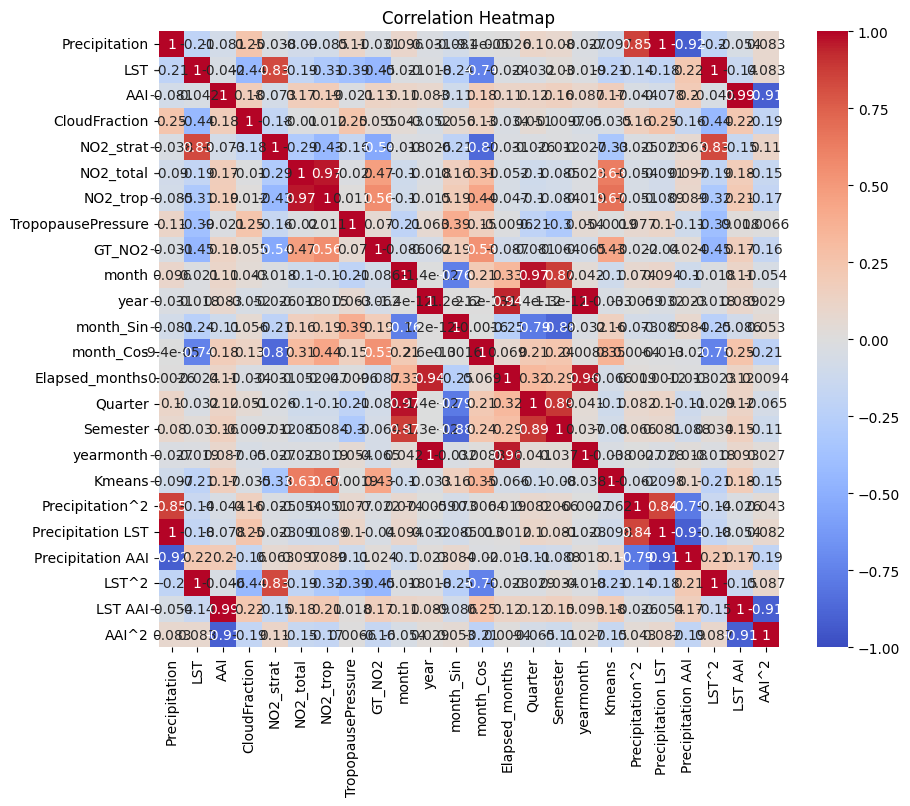

In [25]:
corr = result.corr()
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=ax,vmax=1,vmin=-1)
ax.set_title('Correlation Heatmap')
plt.show()